<a href="https://colab.research.google.com/github/Bbest1365/Glassbottle/blob/main/defect.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# 1. Import necessary libraries
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from statsmodels.tsa.arima_model import ARIMA
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
import warnings;warnings.simplefilter('ignore')
import io

In [ ]:
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly

In [ ]:
# from google.colab import files
# uploaded = files.upload()

In [ ]:

# df = pd.read_csv(io.BytesIO(uploaded['/content/defectl22.csv']))
df = pd.read_csv('/content/defectl22.csv')
# Dataset is now stored in a Pandas Dataframe



In [ ]:
df.dropna(inplace=True)
df.reset_index(drop=True, inplace=True )

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5810 entries, 0 to 5809
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date_time    5810 non-null   object
 1   date         5810 non-null   object
 2   time         5810 non-null   object
 3   Ce_entry     5810 non-null   int64 
 4   ce_exit      5810 non-null   int64 
 5   finish       5810 non-null   int64 
 6   sidewall     5810 non-null   int64 
 7   OLT          5810 non-null   int64 
 8   non_round    5810 non-null   int64 
 9   crack_mouth  5810 non-null   int64 
dtypes: int64(7), object(3)
memory usage: 454.0+ KB


In [ ]:
df

,date_time,date,time,Ce_entry,ce_exit,finish,sidewall,OLT,non_round,crack_mouth
0,01/01/22 00:00-01:00,01/01/22,00:00-01:00,7991,5565,395,142,172,232,73
1,01/01/22 01:00-02:00,01/01/22,01:00-02:00,8283,5270,350,152,103,178,52
2,01/01/22 02:00-03:00,01/01/22,02:00-03:00,8077,5391,317,144,64,109,48
3,01/01/22 03:00-04:00,01/01/22,03:00-04:00,8185,5623,316,158,22,138,209
4,01/01/22 04:00-05:00,01/01/22,04:00-05:00,7860,6395,325,160,28,103,125
...,...,...,...,...,...,...,...,...,...,...
5805,31/08/22 19:00-20:00,31/08/22,19:00-20:00,8867,8023,159,106,8,192,16
5806,31/08/22 20:00-21:00,31/08/22,20:00-21:00,8798,8108,139,54,18,236,34
5807,31/08/22 21:00-22:00,31/08/22,21:00-22:00,9033,8258,125,130,19,185,22
5808,31/08/22 22:00-23:00,31/08/22,22:00-23:00,8889,8354,130,69,21,89,27


In [ ]:
df = df[['date_time','finish']]
df.head()

,date_time,finish
0,01/01/22 00:00-01:00,395
1,01/01/22 01:00-02:00,350
2,01/01/22 02:00-03:00,317
3,01/01/22 03:00-04:00,316
4,01/01/22 04:00-05:00,325


In [ ]:
df['date_time'] = df['date_time'].apply(lambda x :str(x)[:8])+" "+df['date_time'].apply(lambda x :str(x)[-5:]) +":00"
df['date_time']

0       01/01/22 01:00:00
1       01/01/22 02:00:00
2       01/01/22 03:00:00
3       01/01/22 04:00:00
4       01/01/22 05:00:00
              ...        
5805    31/08/22 20:00:00
5806    31/08/22 21:00:00
5807    31/08/22 22:00:00
5808    31/08/22 23:00:00
5809    31/08/22 00:00:00
Name: date_time, Length: 5810, dtype: object

In [ ]:
df.columns = ['ds','y']

In [ ]:
df['df'] = pd.to_datetime(df['ds'],errors='coerce')
df.tail()

,ds,y,df
5805,31/08/22 20:00:00,159,2022-08-31 20:00:00
5806,31/08/22 21:00:00,139,2022-08-31 21:00:00
5807,31/08/22 22:00:00,125,2022-08-31 22:00:00
5808,31/08/22 23:00:00,130,2022-08-31 23:00:00
5809,31/08/22 00:00:00,144,2022-08-31 00:00:00


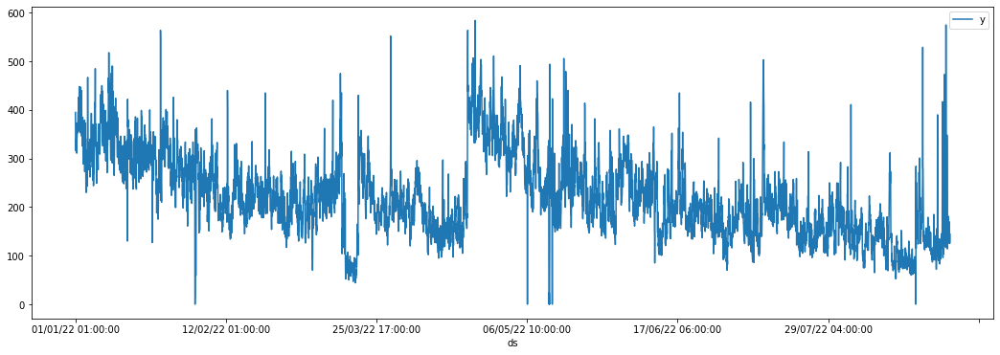

In [ ]:
df.plot(x='ds' ,y='y',figsize=(18,6))

In [ ]:
len(df) # hours

5810

## Train, Test, Split

In [ ]:
# train = df.iloc[:len(df)-365]
# test = df.iloc[len(df)-365:]

## Start Making Prediction

In [ ]:
m= Prophet()
m.fit(df)
future = m.make_future_dataframe(periods=5810,freq='H') #MS for monthly, H for hourly
forecast = m.predict(future)

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpax4isjw5/5z4i2_p1.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpax4isjw5/llf26jvx.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.8/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=4447', 'data', 'file=/tmp/tmpax4isjw5/5z4i2_p1.json', 'init=/tmp/tmpax4isjw5/llf26jvx.json', 'output', 'file=/tmp/tmpax4isjw5/prophet_modeloika0rvy/prophet_model-20230122094209.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
09:42:09 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
09:42:10 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
forecast

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-01-01 00:00:00,279.749432,174.906121,364.039377,279.749432,279.749432,-11.745100,-11.745100,-11.745100,-10.016800,-10.016800,-10.016800,-1.728300,-1.728300,-1.728300,0.0,0.0,0.0,268.004332
1,2022-01-01 01:00:00,279.738025,171.470881,367.039070,279.738025,279.738025,-11.759760,-11.759760,-11.759760,-10.475875,-10.475875,-10.475875,-1.283885,-1.283885,-1.283885,0.0,0.0,0.0,267.978265
2,2022-01-01 02:00:00,279.726617,170.049593,359.572047,279.726617,279.726617,-10.329096,-10.329096,-10.329096,-9.470420,-9.470420,-9.470420,-0.858675,-0.858675,-0.858675,0.0,0.0,0.0,269.397521
3,2022-01-01 03:00:00,279.715210,173.978240,363.537410,279.715210,279.715210,-8.162707,-8.162707,-8.162707,-7.705544,-7.705544,-7.705544,-0.457162,-0.457162,-0.457162,0.0,0.0,0.0,271.552503
4,2022-01-01 04:00:00,279.703803,181.239495,366.037350,279.703803,279.703803,-6.143150,-6.143150,-6.143150,-6.059465,-6.059465,-6.059465,-0.083685,-0.083685,-0.083685,0.0,0.0,0.0,273.560652
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11615,2023-08-07 21:00:00,352.162336,-85.027382,769.386856,-51.688529,768.416317,-3.530708,-3.530708,-3.530708,-7.948167,-7.948167,-7.948167,4.417459,4.417459,4.417459,0.0,0.0,0.0,348.631627
11616,2023-08-07 22:00:00,352.183749,-59.982670,773.683605,-51.726839,768.574147,-2.200069,-2.200069,-2.200069,-7.518979,-7.518979,-7.518979,5.318910,5.318910,5.318910,0.0,0.0,0.0,349.983680
11617,2023-08-07 23:00:00,352.205162,-55.711836,765.630705,-51.765150,768.731977,-2.361778,-2.361778,-2.361778,-8.556771,-8.556771,-8.556771,6.194993,6.194993,6.194993,0.0,0.0,0.0,349.843384
11618,2023-08-08 00:00:00,352.226575,-62.085878,776.550982,-51.803460,768.820949,-2.975484,-2.975484,-2.975484,-10.016800,-10.016800,-10.016800,7.041316,7.041316,7.041316,0.0,0.0,0.0,349.251091


In [ ]:
forecast[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]


,ds,yhat,yhat_lower,yhat_upper
0,2022-01-01 00:00:00,268.004332,174.906121,364.039377
1,2022-01-01 01:00:00,267.978265,171.470881,367.039070
2,2022-01-01 02:00:00,269.397521,170.049593,359.572047
3,2022-01-01 03:00:00,271.552503,173.978240,363.537410
4,2022-01-01 04:00:00,273.560652,181.239495,366.037350
...,...,...,...,...
11615,2023-08-07 21:00:00,348.631627,-85.027382,769.386856
11616,2023-08-07 22:00:00,349.983680,-59.982670,773.683605
11617,2023-08-07 23:00:00,349.843384,-55.711836,765.630705
11618,2023-08-08 00:00:00,349.251091,-62.085878,776.550982


In [ ]:
test.tail()

,ds,y,df
5805,31/08/22 20:00:00,159,2022-08-31 20:00:00
5806,31/08/22 21:00:00,139,2022-08-31 21:00:00
5807,31/08/22 22:00:00,125,2022-08-31 22:00:00
5808,31/08/22 23:00:00,130,2022-08-31 23:00:00
5809,31/08/22 00:00:00,144,2022-08-31 00:00:00


In [ ]:
# print(df['Ce_entry'].unique())
# print(df['ce_exit'].unique())
# print(df['finish'].unique())
# print(df['sidewall'].unique())
# print(df['OLT'].unique())
# print(df['non_round'].unique())
# print(df['crack_mouth'].unique())


In [ ]:
# df['Year'] = df['date'].apply(lambda x: str(x)[-3:])
# df['Month'] = df['date'].apply(lambda x: str(x)[-6:-4])
# df['Day'] = df['date'].apply(lambda x: str(x)[:-7])
# df['ds'] = pd.DatetimeIndex(df['Day']+'-'+df['Month']+'-'+df['Year'])


In [ ]:
# df

In [ ]:
df.describe

<bound method NDFrame.describe of                  date_time       date         time  Ce_entry  ce_exit  finish  \
0     01/01/22 00:00-01:00  01/01/22   00:00-01:00      7991     5565     395   
1     01/01/22 01:00-02:00  01/01/22   01:00-02:00      8283     5270     350   
2     01/01/22 02:00-03:00  01/01/22   02:00-03:00      8077     5391     317   
3     01/01/22 03:00-04:00  01/01/22   03:00-04:00      8185     5623     316   
4     01/01/22 04:00-05:00  01/01/22   04:00-05:00      7860     6395     325   
...                    ...        ...          ...       ...      ...     ...   
5805  31/08/22 19:00-20:00  31/08/22   19:00-20:00      8867     8023     159   
5806  31/08/22 20:00-21:00  31/08/22   20:00-21:00      8798     8108     139   
5807  31/08/22 21:00-22:00  31/08/22   21:00-22:00      9033     8258     125   
5808  31/08/22 22:00-23:00  31/08/22   22:00-23:00      8889     8354     130   
5809  31/08/22 23:00-00:00  31/08/22   23:00-00:00      8914     8346     1

In [ ]:
df.dtypes

date_time              object
date                   object
time                   object
Ce_entry                int64
ce_exit                 int64
finish                  int64
sidewall                int64
OLT                     int64
non_round               int64
crack_mouth             int64
Year                   object
Month                  object
Day                    object
ds             datetime64[ns]
dtype: object

In [ ]:
df.drop(['date','time','Ce_entry','ce_exit','sidewall','OLT','non_round','crack_mouth','Year','Month','Day'], axis=1, inplace=True)
df.columns=['y','ds']
pd.set_option('display.max_rows', None)
 

In [ ]:
m = Prophet(interval_width=0.95, daily_seasonality=True)
model = m.fit(df)

13:39:35 - cmdstanpy - INFO - Chain [1] start processing
13:39:37 - cmdstanpy - INFO - Chain [1] done processing


In [ ]:
future = m.make_future_dataframe(periods=100,freq='D')
forecast = m.predict(future)
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-01-01,370.826568,138.613918,432.595865,370.826568,370.826568,-86.598572,-86.598572,-86.598572,-90.624886,-90.624886,-90.624886,4.026315,4.026315,4.026315,0.0,0.0,0.0,284.227996
1,2022-01-02,370.512816,120.079705,417.108175,370.512816,370.512816,-101.738623,-101.738623,-101.738623,-90.624886,-90.624886,-90.624886,-11.113736,-11.113736,-11.113736,0.0,0.0,0.0,268.774193
2,2022-01-03,370.199064,133.435184,437.243386,370.199064,370.199064,-95.192965,-95.192965,-95.192965,-90.624886,-90.624886,-90.624886,-4.568079,-4.568079,-4.568079,0.0,0.0,0.0,275.006099
3,2022-01-04,369.885312,156.077271,439.736368,369.885312,369.885312,-75.349746,-75.349746,-75.349746,-90.624886,-90.624886,-90.624886,15.275141,15.275141,15.275141,0.0,0.0,0.0,294.535567
4,2022-01-05,369.571561,143.947353,429.211701,369.571561,369.571561,-84.631293,-84.631293,-84.631293,-90.624886,-90.624886,-90.624886,5.993594,5.993594,5.993594,0.0,0.0,0.0,284.940268


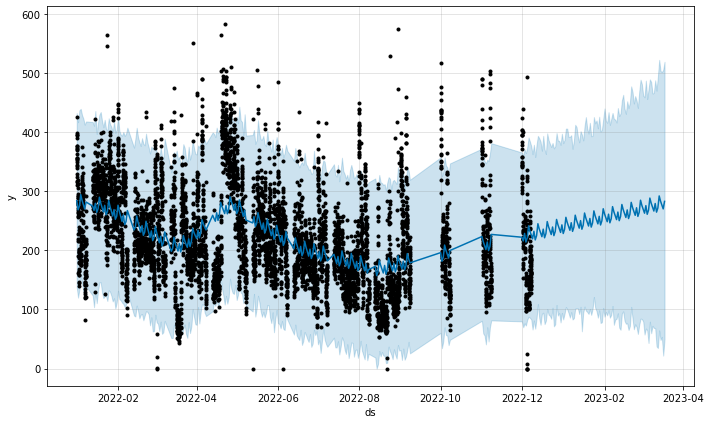

In [ ]:
plot1 = m.plot(forecast)

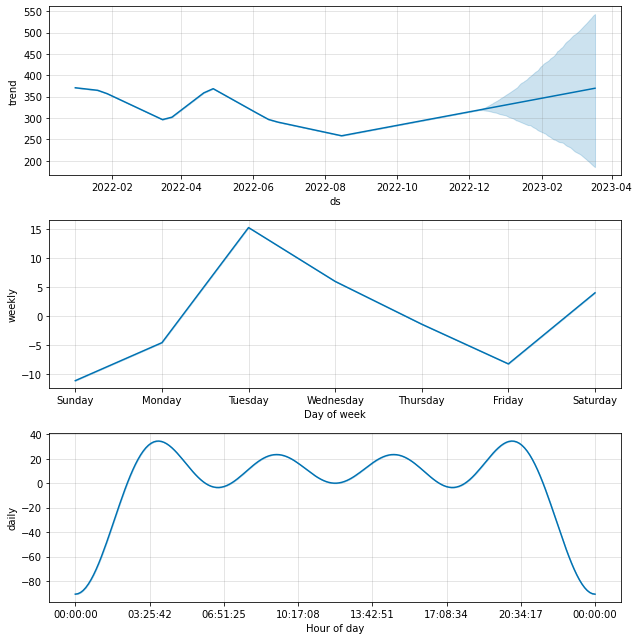

In [ ]:
plt2 = m.plot_components(forecast)

In [ ]:
plot1.show()